# Abhik Ghosh
# E23CSEU0504
# Milestone 2
# CSET211

---
## Hand Gesture Recognition Project using HaGRID 150k Dataset

In this project, we will be working on hand gesture recognition using the HaGRID 150k dataset. This project is divided into several milestones, each focusing on different aspects of the workflow.

---


### Milestone 2—5 Marks

* **Related Work Related to the Topic (1 mark)**
    * Review and summarize existing research and methodologies related to hand gesture recognition.
    
* **Data Pre-processing (1 mark)**
    * Perform data cleaning, normalization, and augmentation to prepare the dataset for model training.
    
* **Data Visualization / EDA using Python Libraries (0.5 marks)**
    * Use Python libraries such as Matplotlib and Seaborn to visualize the dataset and perform exploratory data analysis (EDA).
    
* **Model Creation and Testing (More than one model) (2.5 marks)**
    * Develop and test multiple machine learning models to identify the best-performing model for hand gesture recognition.

---

### Related Work Related to Hand Gesture Recognition

Hand gesture recognition has been an active area of research due to its applications in human-computer interaction, sign language recognition, and virtual reality. Below are some notable works and methodologies in this field:

1. **Vision-Based Approaches**:
    * **Convolutional Neural Networks (CNNs)**: CNNs have been widely used for hand gesture recognition due to their ability to automatically extract features from images. Researchers have developed various CNN architectures to improve accuracy and efficiency.

    * eg: [Paper 1](https://ieeexplore.ieee.org/abstract/document/6899454)
          [Paper 2](https://link.springer.com/chapter/10.1007/978-981-10-2107-7_41)

    * **Deep CNN**: Deep convolutional neural networks (CNN or DCNN) are the type most commonly used to identify patterns in images and video.

    * eg: [Paper 1](https://link.springer.com/article/10.1007/s11042-019-7193-4)
          [Paper 2](https://content.iospress.com/articles/journal-of-intelligent-and-fuzzy-systems/ifs200385)


2. **Sensor-Based Approaches**:
    * **Wearable Sensors**: Devices equipped with accelerometers, gyroscopes, and electromyography (EMG) sensors have been used to capture hand movements and muscle activity, providing robust gesture recognition even in low-light conditions.
    * **Leap Motion Controller**: This device uses infrared sensors to track hand and finger movements in real-time, offering high precision for gesture recognition tasks.

    * eg: [Research 1](https://ieeexplore.ieee.org/abstract/document/9314169)
          [Research 2](https://ieeexplore.ieee.org/abstract/document/7874149)
          [Research 3](https://ieeexplore.ieee.org/abstract/document/7163132)

3. **Hybrid Approaches**:
    * Combining vision-based and sensor-based methods can leverage the strengths of both approaches, providing more accurate and reliable gesture recognition systems.

4. **Datasets and Benchmarks**:
    * **HaGRID 150k Dataset**: A large-scale dataset specifically designed for hand gesture recognition, containing diverse hand gestures captured under various conditions.

    * Dataset: [Hagrid 150k](https://www.kaggle.com/datasets/innominate817/hagrid-classification-512p-no-gesture-150k)

5. **Applications**:
    * **Sign Language Recognition**: Systems have been developed to translate sign language gestures into text or speech, aiding communication for the hearing impaired.
    * **Virtual Reality (VR)**: Hand gesture recognition enhances user interaction in VR environments, providing a more immersive experience.
    * **Human-Computer Interaction (HCI)**: Gesture recognition enables intuitive control of devices and applications, improving user experience.

These works highlight the advancements and ongoing research in hand gesture recognition, providing a foundation for developing robust and efficient recognition systems.

---

## Data Pre-processing

Data pre-processing is a crucial step in preparing the dataset for model training. This involves data cleaning, normalization, and augmentation to ensure the dataset is in the best possible shape for training machine learning models.

---

In [1]:
import numpy as np

import os
from PIL import Image
import tensorflow as tf

from tensorflow.keras import datasets, layers, models
import matplotlib.pyplot as plt
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping
from pathlib import Path

from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.models import Sequential
from tensorflow.keras.optimizers import Adam


#from google.colab import drive #Uncomment to enable for google colab
#drive.mount('/content/drive' , force_remount=True)  #Uncomment to enable for google colab

import os
os.environ['KAGGLE_USERNAME'] = "API_USERNAME" # username from the json file
os.environ['KAGGLE_KEY'] = "API_KEY"

---

## Loading the dataset

    1. Downloading from kaggle using API
    2. Downloading manually

---

1. Downloading from Kaggle using API

In [ ]:
!mkdir ~/.kaggle
!touch ~/.kaggle/kaggle.json

api_token = {"username":"KAGGLE_USERNAME","key":"KAGGKLE_KEY"} # Replace with approporiate values

import json

with open('/root/.config/kaggle.json', 'w') as file:
    json.dump(api_token, file)

!chmod 600 ~/.kaggle/kaggle.json

creds = '{"username":"KAGGLE_USERNAME","key":"KAGGLE_KEY"}' # Replace with approporiate values

cred_path = Path('~/.config/kaggle.json').expanduser()
# Save API key to a json file if it does not already exist
if not cred_path.exists():
    cred_path.parent.mkdir(parents=True,exist_ok=True)
    cred_path.write_text(creds)
    cred_path.chmod(0o600)

from kaggle import api

import zipfile, tarfile
dataset_name = 'hagrid-classification-512p-no-gesture-150k'
# dataset_name = 'hagrid-classification-512p-no-gesture-300k'
# dataset_name = 'hagrid-classification-512p-no-gesture'

kaggle_dataset = f'innominate817/{dataset_name}'

archive_dir = Path('./')
dataset_dir = archive_dir/'../data'
archive_path = Path(f'{archive_dir}/{dataset_name}.zip')
dataset_path = Path(f'{dataset_dir}/{dataset_name}')

def file_extract(fname, dest=None):
    "Extract `fname` to `dest` using `tarfile` or `zipfile`."
    if dest is None: dest = Path(fname).parent
    fname = str(fname)
    if   fname.endswith('gz'):  tarfile.open(fname, 'r:gz').extractall(dest)
    elif fname.endswith('zip'): zipfile.ZipFile(fname     ).extractall(dest)
    else: raise Exception(f'Unrecognized archive: {fname}')

if not archive_path.exists():
    api.dataset_download_cli(kaggle_dataset, path=archive_dir)
    file_extract(fname=archive_path, dest=dataset_path)

img_dir = dataset_path/dataset_name
print(img_dir)

2. Loading from local download

In [2]:
img_dir = "D:\datasets\Dataset\hagrid-classification-512p-no-gesture-150k"

<>:1: SyntaxWarning: invalid escape sequence '\d'
<>:1: SyntaxWarning: invalid escape sequence '\d'
C:\Users\Dell\AppData\Local\Temp\ipykernel_23296\2124165349.py:1: SyntaxWarning: invalid escape sequence '\d'
  img_dir = "D:\datasets\Dataset\hagrid-classification-512p-no-gesture-150k"


3. Loading Dataset from path using tensoflow

In [3]:
batch_size = 128 #tweak as needed
img_height = 256 #tweak as needed
img_width = 256 #tweak as needed

train_ds,val_ds = tf.keras.utils.image_dataset_from_directory(
  os.path.abspath(img_dir),
  validation_split=0.2,
  subset="both",
  shuffle=True,
  seed=43,
  image_size=(img_height, img_width),
  batch_size=batch_size)

class_names = train_ds.class_names
print()
print( "Classes: " , class_names)
print()
num_classes = len(class_names)

Found 153735 files belonging to 19 classes.
Using 122988 files for training.
Using 30747 files for validation.

Classes:  ['call', 'dislike', 'fist', 'four', 'like', 'mute', 'no_gesture', 'ok', 'one', 'palm', 'peace', 'peace_inverted', 'rock', 'stop', 'stop_inverted', 'three', 'three2', 'two_up', 'two_up_inverted']



---

## Data Visualization / Exploratory Data Analysis (EDA)

Exploratory Data Analysis (EDA) is a critical step in understanding the dataset and uncovering patterns, anomalies, and relationships within the data. In this section, we will use Python libraries such as Matplotlib and Seaborn to visualize the dataset. This will help us gain insights into the distribution of hand gestures, identify any potential issues with the data, and guide our data preprocessing and model development efforts.

---

1. Loading Sample Images from the dataset

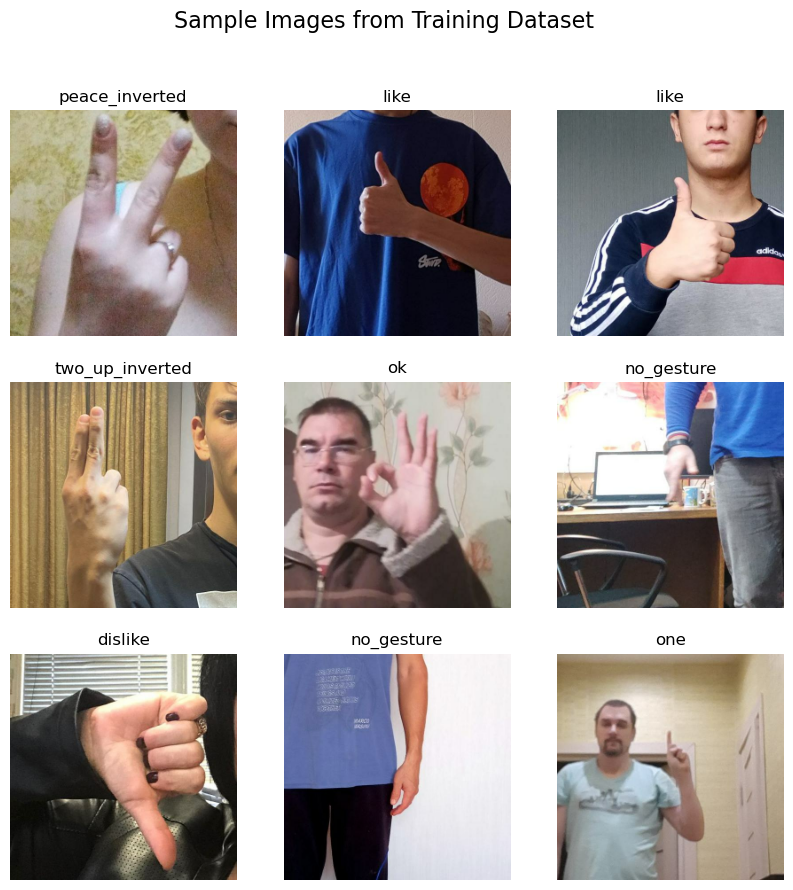

In [5]:
import matplotlib.pyplot as plt

# Function to display images with labels
def display_images(dataset, class_names, num_images=9):
    plt.figure(figsize=(10, 10))
    for images, labels in dataset.take(1):
        for i in range(num_images):
            ax = plt.subplot(3, 3, i + 1)
            plt.imshow(images[i].numpy().astype("uint8"))
            plt.title(class_names[labels[i]])
            plt.axis("off")

# Display images from the training dataset
display_images(train_ds, class_names)
plt.suptitle("Sample Images from Training Dataset", fontsize=16)
plt.show()

2. Checking variety of images for each label class

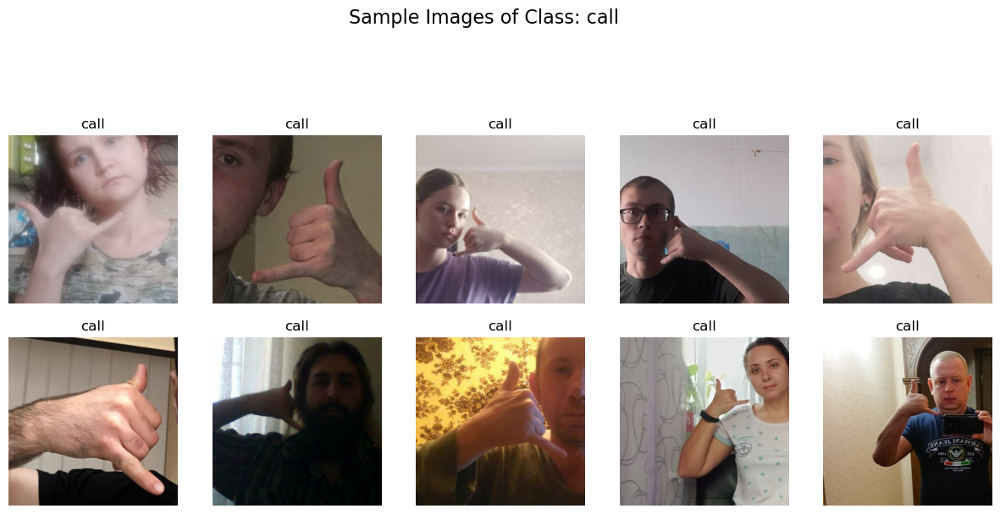

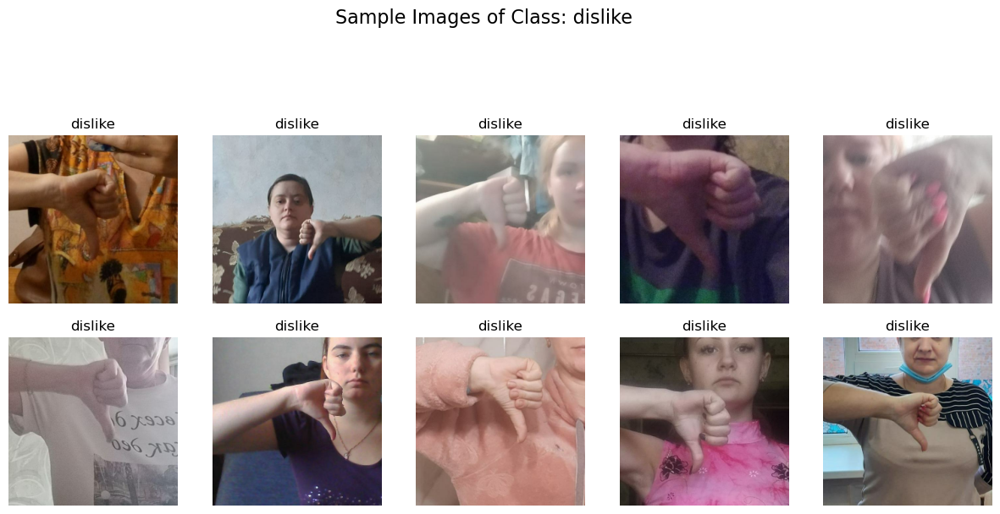

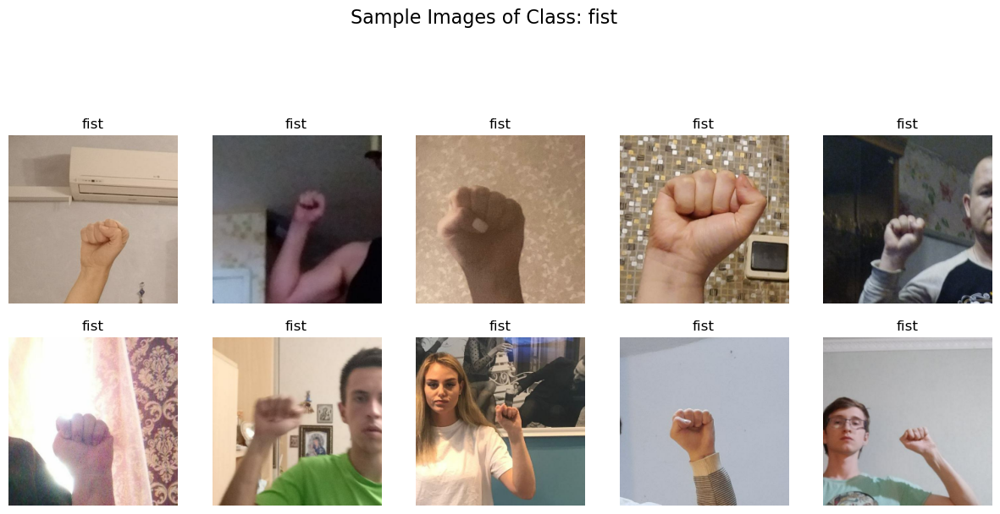

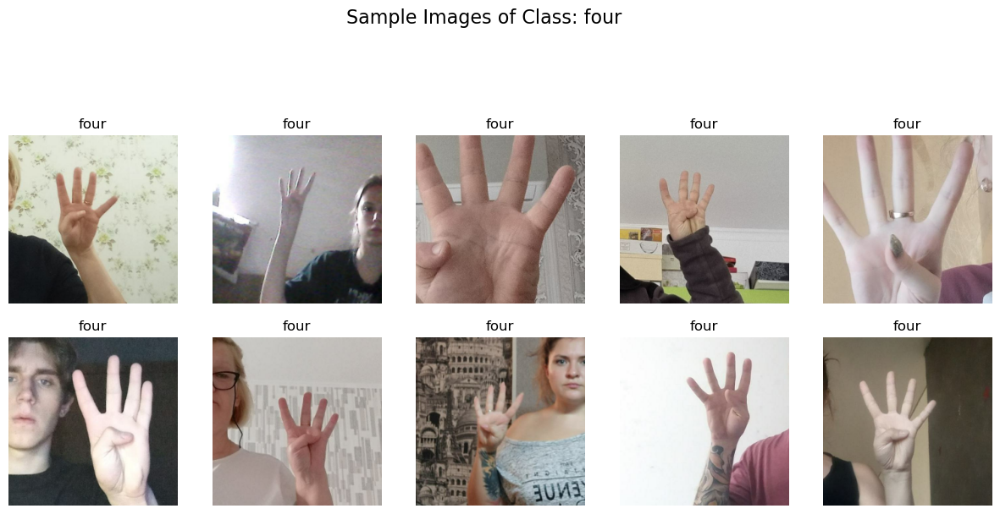

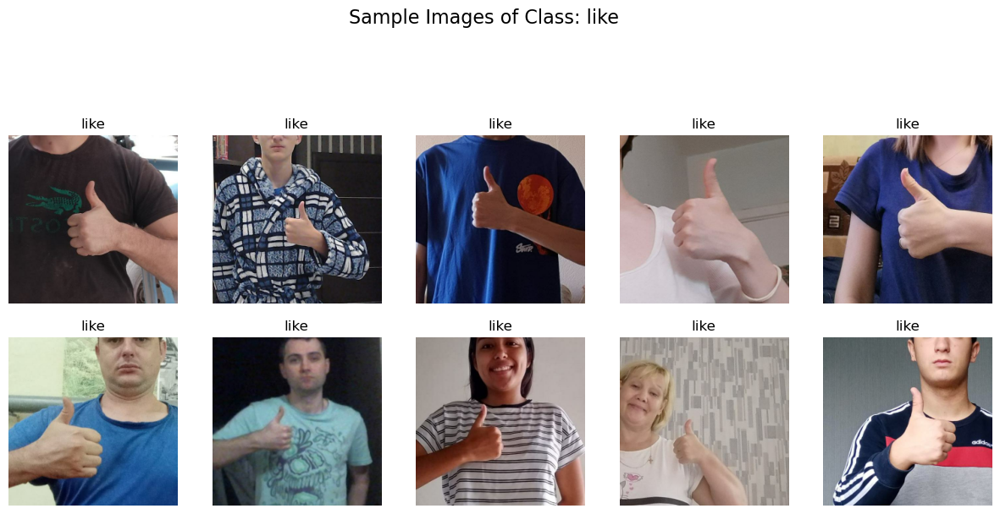

...

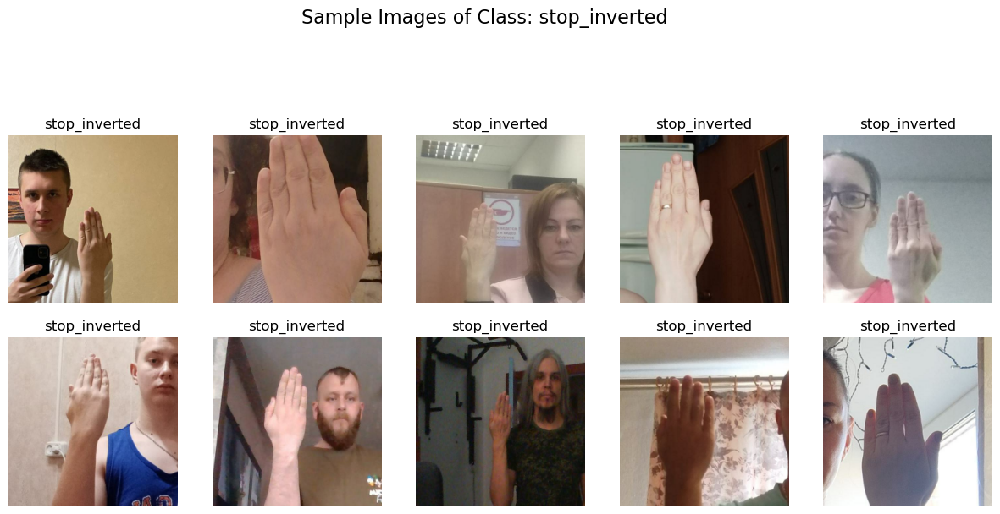

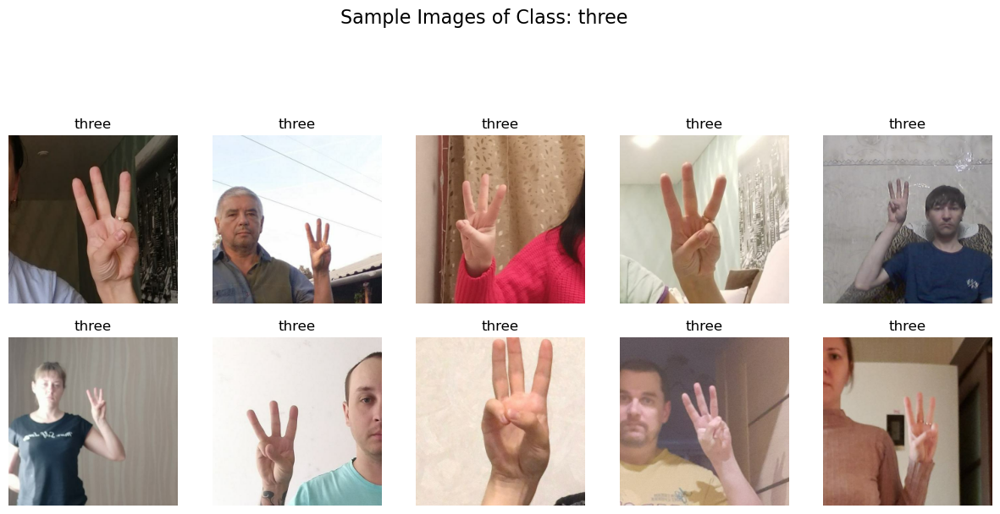

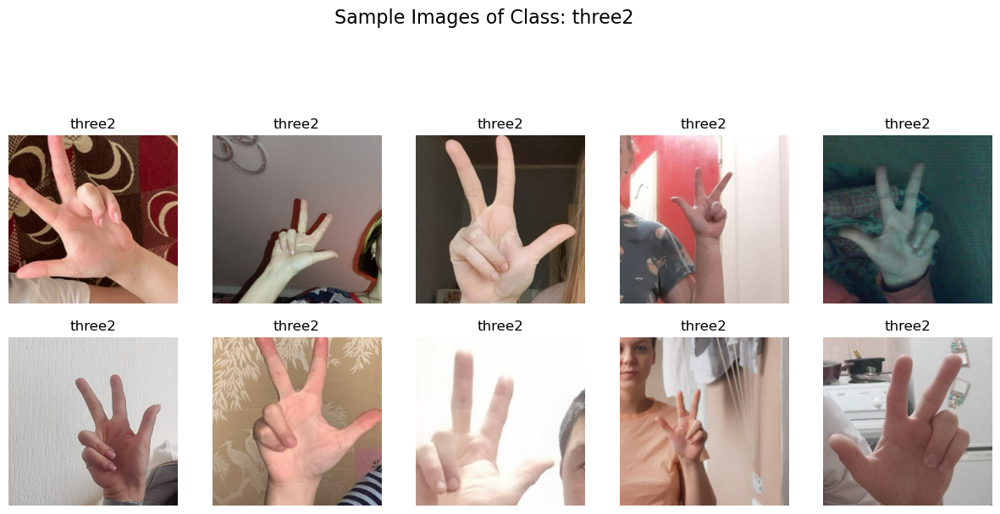

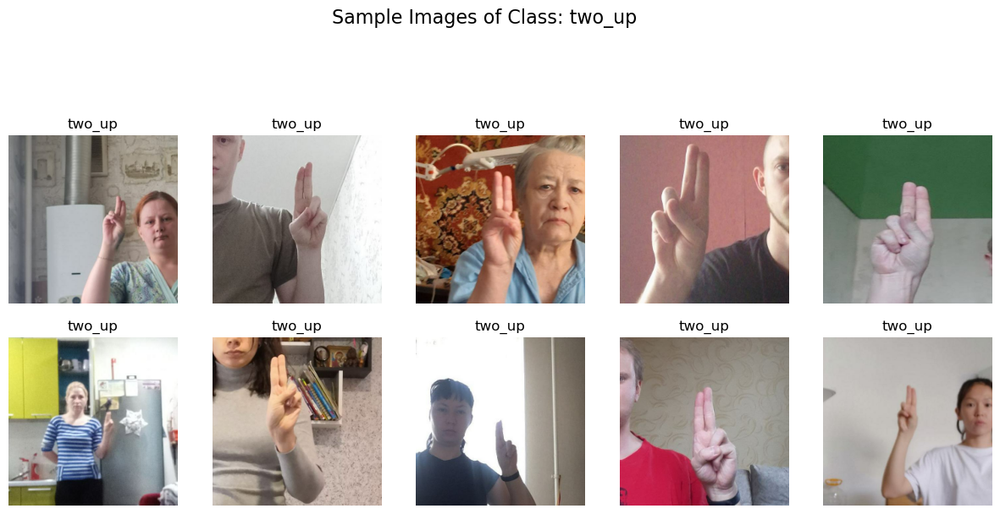

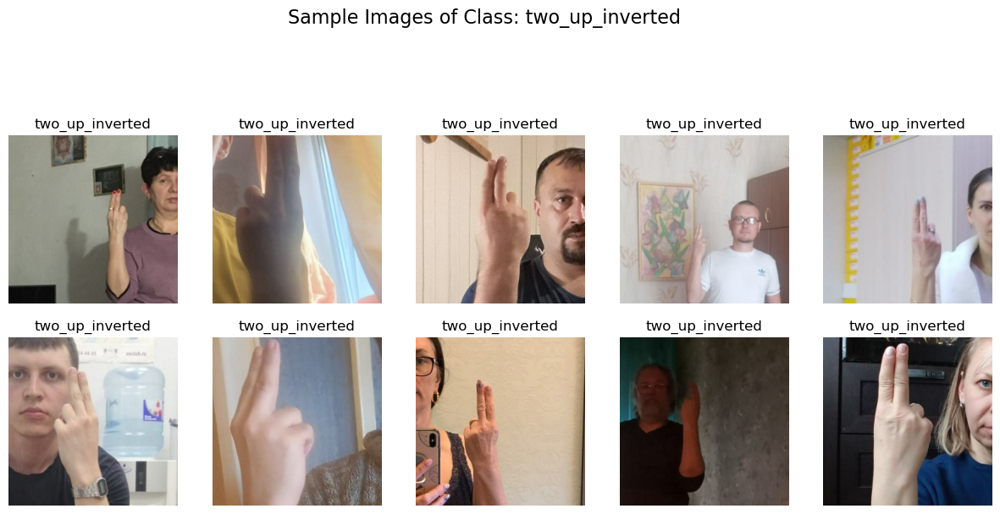

In [17]:
def plot_images_by_class(dataset, class_name, class_names, num_images=10):
    plt.figure(figsize=(15, 15))
    count = 0
    for images, labels in dataset.unbatch():
        if count >= num_images:
            break
        if class_names[labels.numpy()] == class_name:
            ax = plt.subplot(5, 5, count + 1)
            plt.imshow(images.numpy().astype("uint8"))
            plt.title(class_name)
            plt.axis("off")
            count += 1
    plt.suptitle(f"Sample Images of Class: {class_name}", fontsize=16)
    plt.show()

for i in range(len(class_names)):
    plot_images_by_class(train_ds, class_names[i], class_names)
    print()

### What we observe

The dataset selected is excellent and provides many diverse set of images for training and should be much less prone to Overfitting or Underfitting and would result in a fairly accurate model

---

## Data Pre-processing

Data pre-processing is a crucial step in preparing the dataset for model training. This involves data cleaning, normalization, and augmentation to ensure the dataset is in the best possible shape for training machine learning models.

### Data Augmentation

To enhance the diversity of the training data and improve the robustness of the model, we will apply various data augmentation techniques using TensorFlow Keras layers. These techniques include:

* **Random Rotation**: Randomly rotating the images to make the model invariant to the orientation of the hand gestures.
* **Random Zoom**: Randomly zooming into the images to help the model recognize gestures at different scales.
* **Random Flipping**: Randomly flipping the images horizontally to augment the dataset with mirrored versions of the gestures.
* **Image Rescaling**: Rescaling the pixel values of the images to the range [0, 1] by dividing by 255.

These augmentations will be applied to the training dataset to improve the generalization capability of the model.

---

1. Random Rotation in images

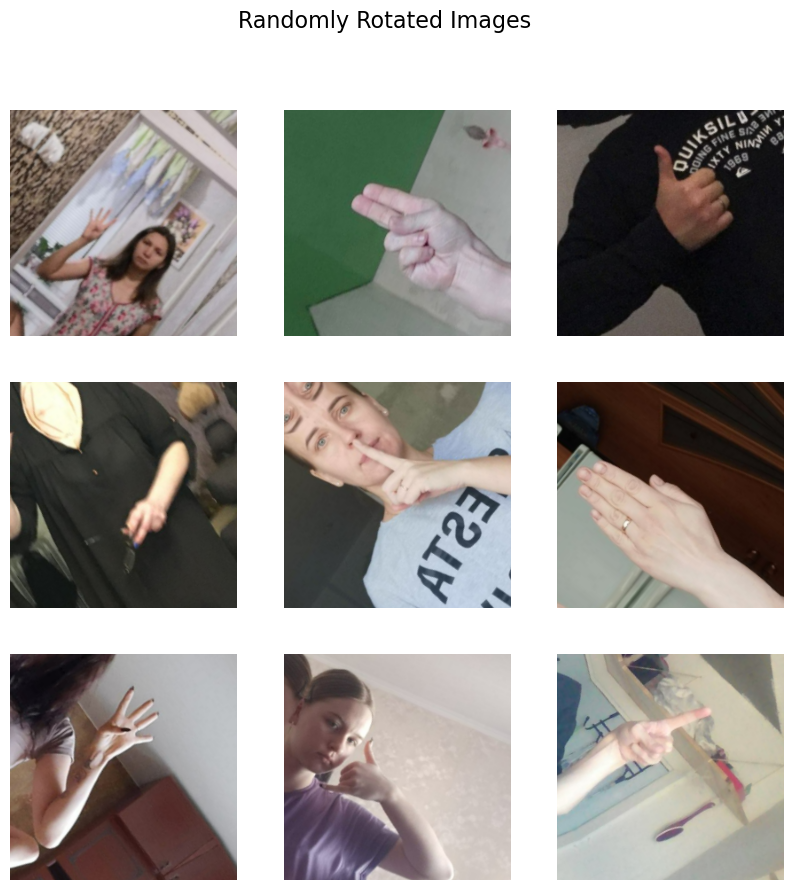

In [21]:
# Define the data augmentation layer for random rotation
data_augmentation = tf.keras.Sequential([
    tf.keras.layers.RandomRotation(0.2)
])

# Function to display augmented images
def display_augmented_images(dataset, augmentation_layer, num_images=9):
    plt.figure(figsize=(10, 10))
    for images, _ in dataset.take(1):
        augmented_images = augmentation_layer(images)
        for i in range(num_images):
            ax = plt.subplot(3, 3, i + 1)
            plt.imshow(augmented_images[i].numpy().astype("uint8"))
            plt.axis("off")
    plt.suptitle("Randomly Rotated Images", fontsize=16)
    plt.show()

# Display augmented images from the training dataset
display_augmented_images(train_ds, data_augmentation)

2. Random Flipping the images

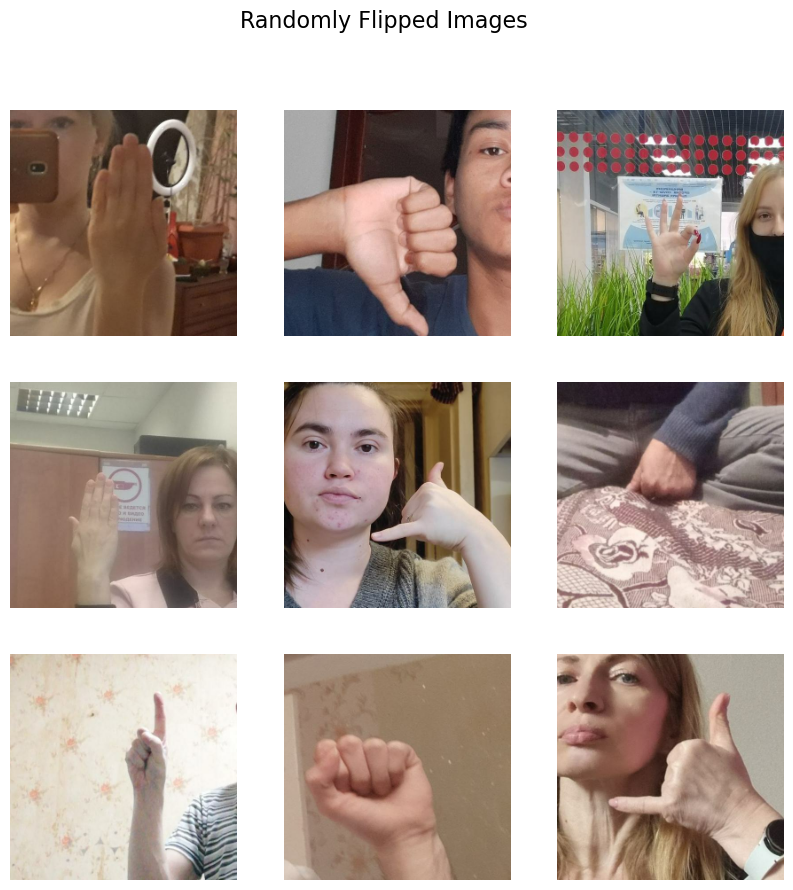

In [22]:
# Define the data augmentation layer for random flipping
data_augmentation_flip = tf.keras.Sequential([
    tf.keras.layers.RandomFlip("horizontal")
])

# Function to display augmented images
def display_augmented_images_flip(dataset, augmentation_layer, num_images=9):
    plt.figure(figsize=(10, 10))
    for images, _ in dataset.take(1):
        augmented_images = augmentation_layer(images)
        for i in range(num_images):
            ax = plt.subplot(3, 3, i + 1)
            plt.imshow(augmented_images[i].numpy().astype("uint8"))
            plt.axis("off")
    plt.suptitle("Randomly Flipped Images", fontsize=16)
    plt.show()

# Display augmented images from the training dataset
display_augmented_images_flip(train_ds, data_augmentation_flip)

3. Random Zooming Images

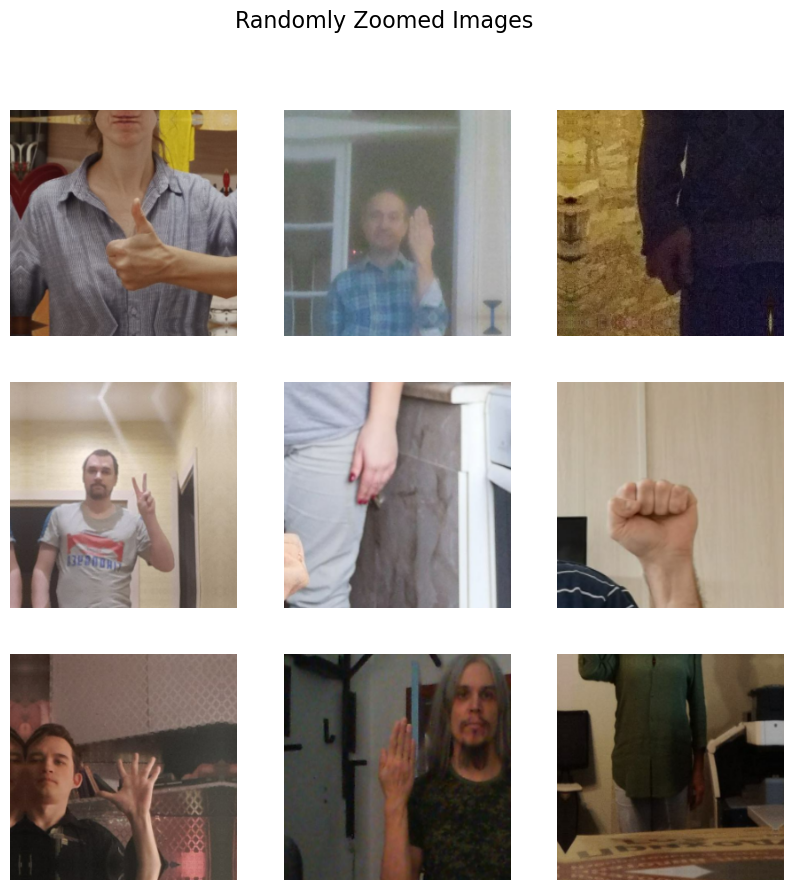

In [23]:
# Define the data augmentation layer for random zoom
data_augmentation_zoom = tf.keras.Sequential([
    tf.keras.layers.RandomZoom(0.2)
])

# Function to display augmented images
def display_augmented_images_zoom(dataset, augmentation_layer, num_images=9):
    plt.figure(figsize=(10, 10))
    for images, _ in dataset.take(1):
        augmented_images = augmentation_layer(images)
        for i in range(num_images):
            ax = plt.subplot(3, 3, i + 1)
            plt.imshow(augmented_images[i].numpy().astype("uint8"))
            plt.axis("off")
    plt.suptitle("Randomly Zoomed Images", fontsize=16)
    plt.show()

# Display augmented images from the training dataset
display_augmented_images_zoom(train_ds, data_augmentation_zoom)

4. Combining all three for a truely diverse training set

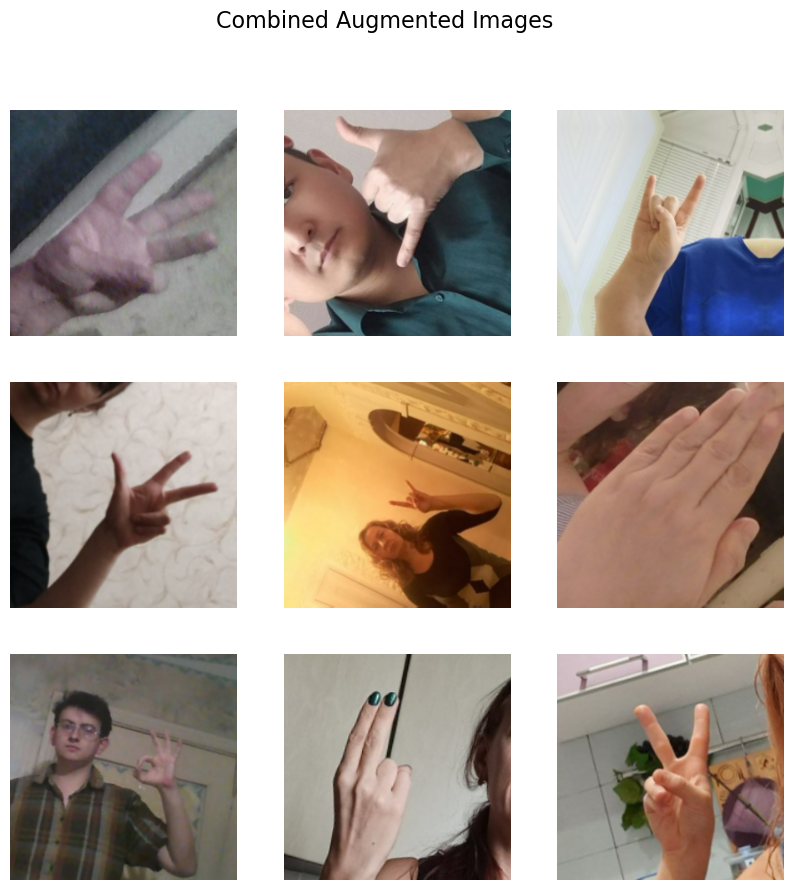

In [44]:
# Define the combined data augmentation layer
combined_data_augmentation = tf.keras.Sequential([
    tf.keras.layers.RandomRotation(0.2),
    tf.keras.layers.RandomFlip("horizontal"),
    tf.keras.layers.RandomZoom(0.2),
])

# Function to display combined augmented images
def display_combined_augmented_images(dataset, augmentation_layer, num_images=9):
    plt.figure(figsize=(10, 10))
    for images, _ in dataset.take(1):
        augmented_images = augmentation_layer(images)
        for i in range(num_images):
            plt.subplot(3, 3, i + 1)
            plt.imshow(augmented_images[i].numpy().astype("uint8"), cmap='gray')
            plt.axis("off")
    plt.suptitle("Combined Augmented Images", fontsize=16)
    plt.show()

# Display combined augmented images from the training dataset
display_combined_augmented_images(train_ds, combined_data_augmentation)

Now we are ready and prepared to create and train the models

---

## Models

In this project, we will develop and compare three different models to identify the best-performing one for hand gesture recognition:

### 1. Simple CNN

A basic Convolutional Neural Network (CNN) model that serves as a starting point for hand gesture recognition. This model will help us understand the baseline performance and identify areas for improvement.

### 2. Complex CNN

A more sophisticated CNN model with additional layers and parameters to capture more complex patterns in the data. This model aims to improve accuracy and robustness compared to the Simple CNN.

### 3. ResNet Model

A state-of-the-art Residual Network (ResNet) model known for its deep architecture and ability to mitigate the vanishing gradient problem. This model is expected to provide the highest accuracy and performance among the three.


### Lets get started

---

#### Defining the data augmentation layers

In [ ]:
data_augmentation = Sequential(
  [
    layers.RandomFlip("horizontal",
                      input_shape=(img_height,
                                  img_width,
                                  3)),
    layers.RandomRotation(0.1),
    layers.RandomZoom(0.1),
    layers.Rescaling(1./255),
  ]
)

---
1. Simple CNN

In [32]:
simple_model = Sequential([
  data_augmentation,
  layers.Conv2D(16, 3, padding='same', activation='relu'),
  layers.MaxPooling2D(),
  layers.Conv2D(32, 3, padding='same', activation='relu'),
  layers.MaxPooling2D(),
  layers.Conv2D(64, 3, padding='same', activation='relu'),
  layers.MaxPooling2D(),
  layers.Dropout(0.2),
  layers.Flatten(),
  layers.Dense(128, activation='relu'),
  layers.Dense(num_classes, name="outputs")
])

simple_model.compile(optimizer=Adam(learning_rate=0.001),
              loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
              metrics=['accuracy'])

    1. Training the model for 15 epochs

In [ ]:
checkpoint_callback = ModelCheckpoint(
        filepath='/content/drive/MyDrive/AI_Model/simple_model_checkpoint_epoch_{epoch:02d}.keras',  # Save model with epoch number (change path if using locally)
        save_freq='epoch',  # Save at the end of every epoch
        monitor='val_loss',  # Monitor validation loss
        save_best_only=False,  # Only save if the validation loss improves
        verbose=1  # Show saving message
    )

    # Early stopping to prevent overfitting (if validation doesn't improve for 5 epochs)
early_stopping_callback = EarlyStopping(
        monitor='val_loss',  # Monitor validation loss
        patience=5,  # Stop training after 5 epochs without improvement
        restore_best_weights=True  # Restore the best weights after stopping
    )


history = simple_model.fit(
        train_ds,
        validation_data=val_ds,
        epochs=15,  # Adjust the number of epochs based on your dataset
        callbacks=[checkpoint_callback, early_stopping_callback],  # Include callbacks
        verbose=1
    )

simple_model.save('/content/drive/MyDrive/AI_Model/simple_model.keras') # change path is using locally

#### Model Summary

In [ ]:
simple_model.summary()

tf.keras.utils.plot_model(
    simple_model,
    to_file='model.png',
    show_shapes=True,
    show_dtype=True,
    show_layer_names=True,
    rankdir='TB',
    expand_nested=True,
    dpi=200,
    show_layer_activations=True,
    show_trainable=True,
)

---
2. Complex CNN

In [ ]:
complex_model = Sequential([
        data_augmentation,
        layers.Conv2D(32, (3, 3), activation='relu', padding='same'),
        layers.BatchNormalization(),
        layers.MaxPooling2D((2, 2)),
        layers.Dropout(0.25),
        
        layers.Conv2D(64, (3, 3), activation='relu', padding='same'),
        layers.BatchNormalization(),
        layers.MaxPooling2D((2, 2)),
        layers.Dropout(0.25),
        
        layers.Conv2D(128, (3, 3), activation='relu', padding='same'),
        layers.BatchNormalization(),
        layers.MaxPooling2D((2, 2)),
        layers.Dropout(0.25),
        
        layers.Flatten(),
        layers.Dense(256, activation='relu'),
        layers.BatchNormalization(),
        layers.Dropout(0.5),
        layers.Dense(num_classes, activation='softmax', name="outputs")
])

complex_model.compile(optimizer=Adam(learning_rate=0.001),
              loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
              metrics=['accuracy'])

    1. Training the model for 15 epochs

In [ ]:
checkpoint_callback = ModelCheckpoint(
        filepath='/content/drive/MyDrive/AI_Model/complex_model_checkpoint_epoch_{epoch:02d}.keras',  # Save model with epoch number (change path if using locally)
        save_freq='epoch',  # Save at the end of every epoch
        monitor='val_loss',  # Monitor validation loss
        save_best_only=False,  # Only save if the validation loss improves
        verbose=1  # Show saving message
    )

    # Early stopping to prevent overfitting (if validation doesn't improve for 5 epochs)
early_stopping_callback = EarlyStopping(
        monitor='val_loss',  # Monitor validation loss
        patience=5,  # Stop training after 5 epochs without improvement
        restore_best_weights=True  # Restore the best weights after stopping
    )


history = complex_model.fit(
        train_ds,
        validation_data=val_ds,
        epochs=15,  # Adjust the number of epochs based on your dataset
        callbacks=[checkpoint_callback, early_stopping_callback],  # Include callbacks
        verbose=1
    )

complex_model.save('/content/drive/MyDrive/AI_Model/complex_model.keras') # change path is using locally

#### Model Summary

In [ ]:
complex_model.summary()
tf.keras.utils.plot_model(
    complex_model,
    to_file='model.png',
    show_shapes=True,
    show_dtype=True,
    show_layer_names=True,
    rankdir='TB',
    expand_nested=True,
    dpi=200,
    show_layer_activations=True,
    show_trainable=True,
)

---
3. ResNet Model

In [45]:
resnet_model = tf.keras.applications.ResNet50(
    include_top=True,
    weights=None,
    input_tensor=None,
    input_shape=(img_height, img_width, 3),
    pooling=None,
    classes=num_classes,
    classifier_activation='softmax'
)

resnet_model.compile(optimizer=Adam(learning_rate=0.001),
                     loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=False),
                     metrics=['accuracy'])

    1. Training the model for 20 epochs

In [ ]:
checkpoint_callback = ModelCheckpoint(
        filepath='/content/drive/MyDrive/AI_Model/res_model_checkpoint_epoch_{epoch:02d}.keras',  # Save model with epoch number (Change path if using locally)
        save_freq='epoch',  # Save at the end of every epoch
        monitor='val_loss',  # Monitor validation loss
        save_best_only=False,  # Only save if the validation loss improves
        verbose=1  # Show saving message
    )

resnet_model.fit(
    train_ds,
    validation_data=val_ds,
    epochs=20,
    callbacks=[checkpoint_callback]
)

resnet_model.save('/content/drive/MyDrive/AI_Model/resnet_model.keras') # change path is using locally

#### Model Summary

In [ ]:
resnet_model.summary()

tf.keras.utils.plot_model(
    resnet_model,
    to_file='model.png',
    show_shapes=True,
    show_dtype=True,
    show_layer_names=True,
    rankdir='TB',
    expand_nested=True,
    dpi=200,
    show_layer_activations=True,
    show_trainable=True,
)

--- 

### Validating the Model using Graphs

---

### Setting things up 

In [ ]:
import tensorflow as tf
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import itertools

# Advanced metrics and visualization libraries
from sklearn.metrics import (
    confusion_matrix, 
    classification_report, 
    roc_curve, 
    precision_recall_curve, 
    average_precision_score,
    f1_score,
    cohen_kappa_score,
    auc  # Import auc function
)

# Set aesthetic plotting parameters
plt.style.use('seaborn')
sns.set_palette("deep")

class ModelEvaluator:
    def __init__(self, model, val_dataset, class_names):
        """
        Initialize the model evaluator with model, validation dataset, and class information
        
        Args:
        - model: Trained TensorFlow/Keras model
        - val_dataset: Validation dataset
        - class_names: List of class names for labeling
        """
        self.model = model
        self.val_dataset = val_dataset
        self.class_names = class_names
        self.predictions = []
        self.true_labels = []
        
    def collect_predictions(self):
        """Collect model predictions and true labels"""
        for images, labels in self.val_dataset:
            pred = self.model.predict(images)
            self.predictions.extend(pred)
            self.true_labels.extend(labels.numpy())
        
        self.predictions = np.array(self.predictions)
        self.true_labels = np.array(self.true_labels)
        
    def plot_comprehensive_metrics(self):
        """Create a comprehensive visualization of model performance"""
        plt.figure(figsize=(20, 15))
        plt.suptitle('Comprehensive Model Performance Analysis', fontsize=16, fontweight='bold')
        
        # 1. Confusion Matrix (Subplot 1)
        plt.subplot(2, 3, 1)
        self._plot_confusion_matrix()
        
        # 2. ROC Curves (Subplot 2)
        plt.subplot(2, 3, 2)
        self._plot_roc_curves()
        
        # 3. Precision-Recall Curves (Subplot 3)
        plt.subplot(2, 3, 3)
        self._plot_precision_recall_curves()
        
        # 4. Prediction Confidence Distribution (Subplot 4)
        plt.subplot(2, 3, 4)
        self._plot_prediction_confidence()
        
        # 5. Per-Class Performance Radar Chart (Subplot 5)
        plt.subplot(2, 3, 5)
        self._plot_class_performance_radar()
        
        # 6. Model Calibration (Subplot 6)
        plt.subplot(2, 3, 6)
        self._plot_calibration_curve()
        
        plt.tight_layout(rect=[0, 0.03, 1, 0.95])
        plt.show()
        
    def _plot_confusion_matrix(self, normalize=True):
        """Create a normalized or absolute confusion matrix"""
        cm = confusion_matrix(self.true_labels, 
                               self.predictions.argmax(axis=1))
        
        if normalize:
            cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
        
        sns.heatmap(cm, annot=True, cmap='YlGnBu', 
                    xticklabels=self.class_names, 
                    yticklabels=self.class_names)
        plt.title('Normalized Confusion Matrix')
        plt.xlabel('Predicted Label')
        plt.ylabel('True Label')
        plt.xticks(rotation=45)
        plt.yticks(rotation=0)
        
    def _plot_roc_curves(self):
        """Plot ROC curves for multi-class classification"""
        from sklearn.preprocessing import label_binarize
        
        # Binarize the output
        y_bin = label_binarize(self.true_labels, 
                                classes=np.unique(self.true_labels))
        n_classes = y_bin.shape[1]
        
        # Compute ROC curve and ROC area for each class
        fpr = dict()
        tpr = dict()
        roc_auc = dict()
        
        for i in range(n_classes):
            fpr[i], tpr[i], _ = roc_curve(y_bin[:, i], self.predictions[:, i])
            roc_auc[i] = auc(fpr[i], tpr[i])
        
        # Plot ROC curves
        colors = plt.cm.Set1(np.linspace(0, 1, n_classes))
        for i, color in zip(range(n_classes), colors):
            plt.plot(fpr[i], tpr[i], color=color, 
                     label=f'ROC curve (class {self.class_names[i]}, area = {roc_auc[i]:.2f})')
        
        plt.plot([0, 1], [0, 1], 'k--')
        plt.xlim([0.0, 1.0])
        plt.ylim([0.0, 1.05])
        plt.xlabel('False Positive Rate')
        plt.ylabel('True Positive Rate')
        plt.title('Receiver Operating Characteristic')
        plt.legend(loc="lower right")
        
    def _plot_precision_recall_curves(self):
        """Plot Precision-Recall curves"""
        from sklearn.preprocessing import label_binarize
        
        y_bin = label_binarize(self.true_labels, 
                                classes=np.unique(self.true_labels))
        n_classes = y_bin.shape[1]
        
        precision = dict()
        recall = dict()
        average_precision = dict()
        
        for i in range(n_classes):
            precision[i], recall[i], _ = precision_recall_curve(y_bin[:, i], 
                                                                self.predictions[:, i])
            average_precision[i] = average_precision_score(y_bin[:, i], 
                                                           self.predictions[:, i])
        
        colors = plt.cm.Set1(np.linspace(0, 1, n_classes))
        for i, color in zip(range(n_classes), colors):
            plt.plot(recall[i], precision[i], color=color, 
                     label=f'Precision-Recall (class {self.class_names[i]}, AP = {average_precision[i]:.2f})')
        
        plt.xlabel('Recall')
        plt.ylabel('Precision')
        plt.title('Precision-Recall Curve')
        plt.legend(loc="lower left")
        
    def _plot_prediction_confidence(self):
        """Visualize prediction confidence distribution"""
        confidences = self.predictions.max(axis=1)
        plt.hist(confidences, bins=50, color='skyblue', edgecolor='black')
        plt.title('Prediction Confidence Distribution')
        plt.xlabel('Confidence')
        plt.ylabel('Frequency')
        
    def _plot_class_performance_radar(self):
        """Create a radar chart showing per-class performance metrics"""
        from sklearn.metrics import precision_recall_fscore_support
        
        metrics = precision_recall_fscore_support(
            self.true_labels, 
            self.predictions.argmax(axis=1), 
            average=None
        )
        
        # Precision, Recall, F1-score for each class
        angles = np.linspace(0, 2*np.pi, len(self.class_names), endpoint=False)
        values = metrics[2]  # F1 scores
        
        # Close the plot
        values = np.concatenate((values, [values[0]]))
        angles = np.concatenate((angles, [angles[0]]))
        
        plt.polar(angles, values, 'o-', linewidth=2)
        plt.fill(angles, values, alpha=0.25)
        plt.xticks(angles[:-1], self.class_names)
        plt.title('Class Performance Radar')
        
    def _plot_calibration_curve(self):
        """Plot model calibration"""
        from sklearn.calibration import calibration_curve
        
        plt.plot([0, 1], [0, 1], linestyle='--', label='Perfectly calibrated')
        
        for i in range(len(self.class_names)):
            prob_true, prob_pred = calibration_curve(
                self.true_labels == i, 
                self.predictions[:, i]
            )
            plt.plot(prob_pred, prob_true, marker='o', 
                     label=f'Class {self.class_names[i]}')
        
        plt.xlabel('Mean predicted probability')
        plt.ylabel('Fraction of positives')
        plt.title('Calibration Plot')
        plt.legend(loc='lower right')
        
    def generate_detailed_report(self):
        """Generate a comprehensive textual report"""
        report = classification_report(
            self.true_labels, 
            self.predictions.argmax(axis=1), 
            target_names=self.class_names
        )
        
        additional_metrics = {
            'Cohen\'s Kappa': cohen_kappa_score(
                self.true_labels, 
                self.predictions.argmax(axis=1)
            )
        }
        
        print("Comprehensive Classification Report:")
        print(report)
        print("\nAdditional Metrics:")
        for metric, value in additional_metrics.items():
            print(f"{metric}: {value:.4f}")
        
    def save_results(self, filename='model_evaluation_results.csv'):
        """Save detailed prediction results"""
        results_df = pd.DataFrame({
            'True_Label': [self.class_names[label] for label in self.true_labels],
            'Predicted_Label': [self.class_names[pred] for pred in self.predictions.argmax(axis=1)],
            'Confidence': self.predictions.max(axis=1)
        })
        results_df.to_csv(filename, index=False)
        print(f"Results saved to {filename}")

### Simple CNN

<ipython-input-9-43b6755f1b4c>:185: UserWarning: Trying to create polar plot on an Axes that does not have a polar projection.
  plt.polar(angles, values, 'o-', linewidth=2)


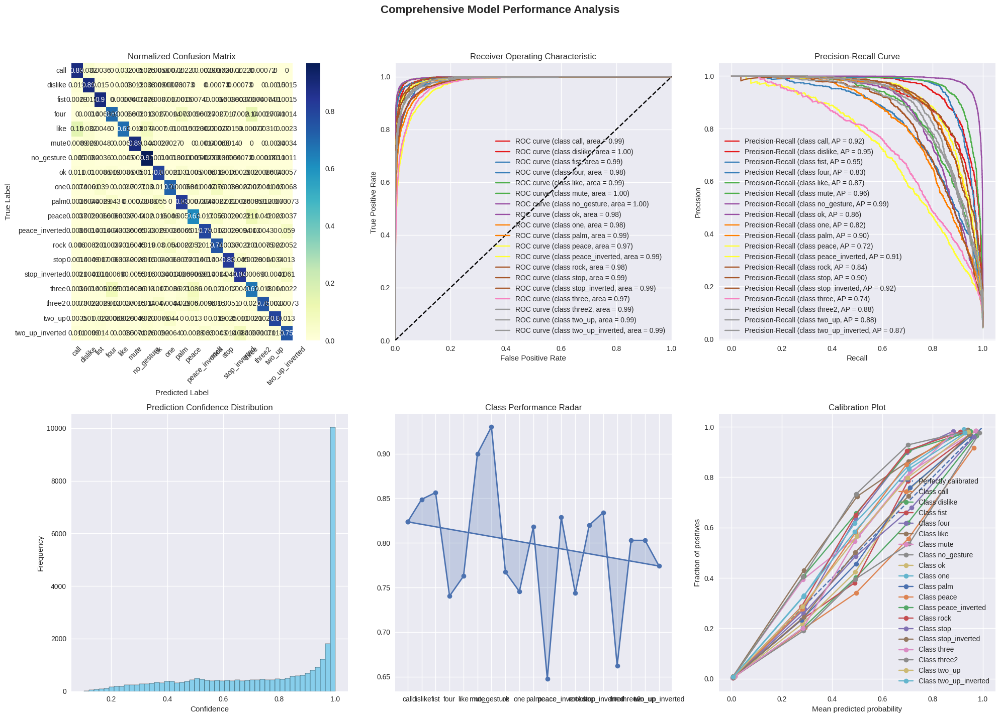

Comprehensive Classification Report:
                 precision    recall  f1-score   support

           call       0.77      0.89      0.82      1389
        dislike       0.81      0.89      0.85      1379
           fist       0.82      0.90      0.86      1360
           four       0.79      0.69      0.74      1465
           like       0.86      0.69      0.76      1294
           mute       0.91      0.89      0.90      1460
     no_gesture       0.90      0.97      0.93      5586
             ok       0.74      0.80      0.77      1399
            one       0.78      0.71      0.75      1479
           palm       0.81      0.83      0.82      1371
          peace       0.67      0.63      0.65      1366
 peace_inverted       0.87      0.79      0.83      1390
           rock       0.74      0.74      0.74      1337
           stop       0.81      0.83      0.82      1423
  stop_inverted       0.83      0.84      0.83      1456
          three       0.66      0.67      0.66    

In [ ]:
model = tf.keras.models.load_model('simple_model.keras')

evaluator = ModelEvaluator(model, val_ds, class_names)
evaluator.collect_predictions()
evaluator.plot_comprehensive_metrics()
evaluator.generate_detailed_report()
evaluator.save_results()

### Complex CNN

<ipython-input-9-43b6755f1b4c>:185: UserWarning: Trying to create polar plot on an Axes that does not have a polar projection.
  plt.polar(angles, values, 'o-', linewidth=2)


Comprehensive Classification Report:
                 precision    recall  f1-score   support

           call       0.73      0.82      0.77      1389
        dislike       0.83      0.77      0.80      1379
           fist       0.79      0.80      0.80      1360
           four       0.64      0.64      0.64      1465
           like       0.76      0.69      0.72      1294
           mute       0.86      0.84      0.85      1460
     no_gesture       0.88      0.94      0.91      5586
             ok       0.69      0.58      0.63      1399
            one       0.69      0.61      0.65      1479
           palm       0.70      0.77      0.73      1371
          peace       0.61      0.46      0.53      1366
 peace_inverted       0.72      0.73      0.72      1390
           rock       0.60      0.66      0.63      1337
           stop       0.80      0.65      0.72      1423
  stop_inverted       0.68      0.81      0.74      1456
          three       0.52      0.60      0.56    

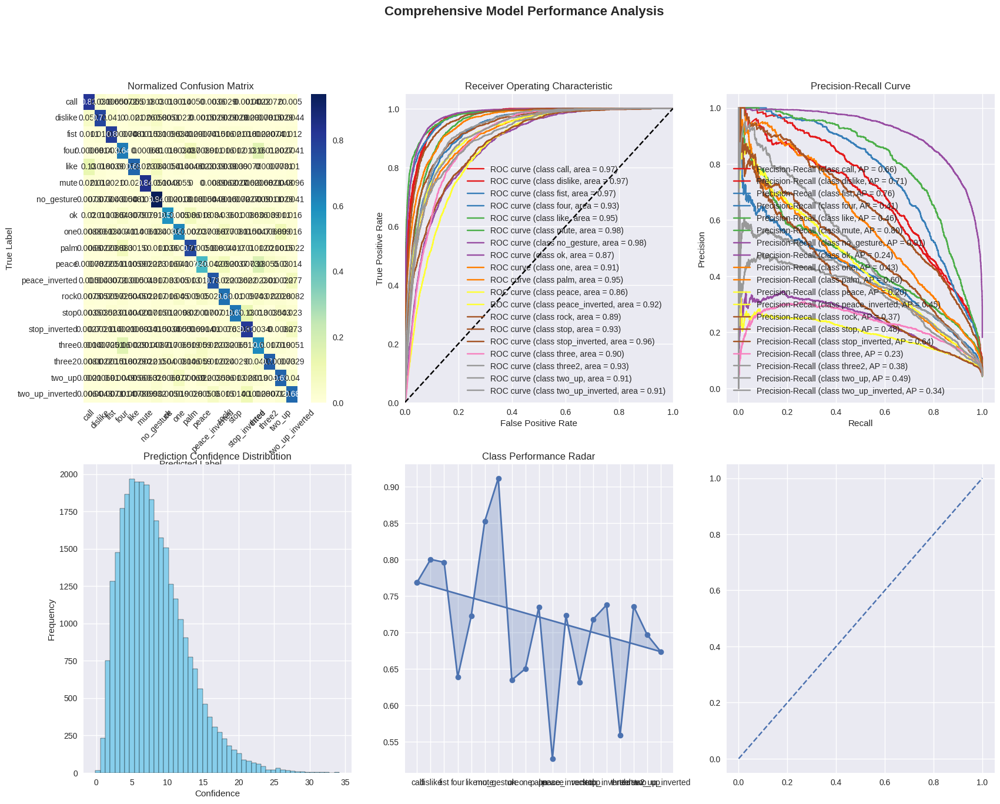

In [ ]:
model = tf.keras.models.load_model('complex_model.keras')

evaluator = ModelEvaluator(model, val_ds, class_names)
evaluator.collect_predictions()
evaluator.plot_comprehensive_metrics()
evaluator.generate_detailed_report()
evaluator.save_results()

### RES-NET Model

<ipython-input-9-43b6755f1b4c>:185: UserWarning: Trying to create polar plot on an Axes that does not have a polar projection.
  plt.polar(angles, values, 'o-', linewidth=2)


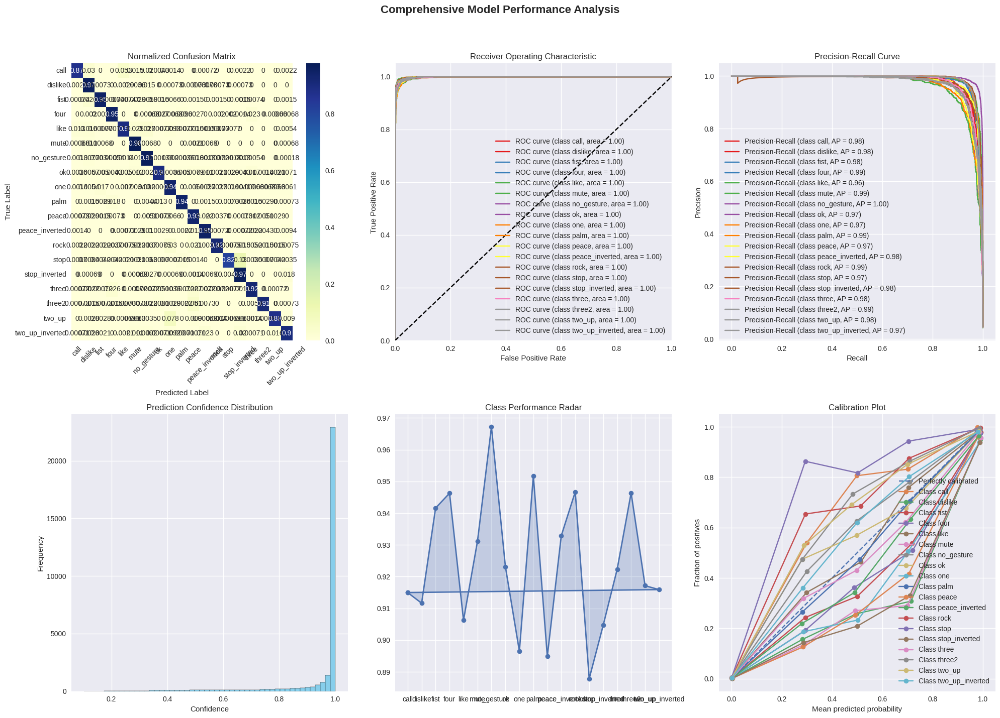

Comprehensive Classification Report:
                 precision    recall  f1-score   support

           call       0.96      0.87      0.91      1389
        dislike       0.86      0.97      0.91      1379
           fist       0.93      0.95      0.94      1360
           four       0.94      0.95      0.95      1465
           like       0.92      0.90      0.91      1294
           mute       0.89      0.98      0.93      1460
     no_gesture       0.97      0.97      0.97      5586
             ok       0.95      0.90      0.92      1399
            one       0.86      0.94      0.90      1479
           palm       0.96      0.94      0.95      1371
          peace       0.86      0.93      0.89      1366
 peace_inverted       0.92      0.95      0.93      1390
           rock       0.98      0.92      0.95      1337
           stop       0.97      0.82      0.89      1423
  stop_inverted       0.85      0.97      0.90      1456
          three       0.92      0.92      0.92    

In [ ]:
model = tf.keras.models.load_model('resnet_model.keras')

evaluator = ModelEvaluator(model, val_ds, class_names)
evaluator.collect_predictions()
evaluator.plot_comprehensive_metrics()
evaluator.generate_detailed_report()
evaluator.save_results()